In [1]:
import warnings

import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns

import qgrid
from tqdm.auto import tqdm
from statsmodels.tsa.seasonal import MSTL

sns.set(style="ticks", palette="muted", color_codes=True)

warnings.filterwarnings("ignore")

plt.rcParams['axes.labelsize'] = 15
plt.rcParams['axes.titlesize'] = 20

seed = 42

In [2]:
df = pd.read_csv("datasets/Combined_Merged_Weather_Data.csv", parse_dates=['DATE'])

In [3]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 237380 entries, 0 to 237379
Data columns (total 24 columns):
 #   Column       Non-Null Count   Dtype         
---  ------       --------------   -----         
 0   STAID        237380 non-null  int64         
 1   DATE         237380 non-null  datetime64[ns]
 2   CC           204512 non-null  float64       
 3   Q_CC         204512 non-null  float64       
 4   FG           230076 non-null  float64       
 5   Q_FG         230076 non-null  float64       
 6   HU           166166 non-null  float64       
 7   Q_HU         166166 non-null  float64       
 8   PP           102256 non-null  float64       
 9   Q_PP         102256 non-null  float64       
 10  QQ           98604 non-null   float64       
 11  Q_QQ         98604 non-null   float64       
 12  RR           199034 non-null  float64       
 13  Q_RR         199034 non-null  float64       
 14  SD           204512 non-null  float64       
 15  Q_SD         204512 non-null  floa

In [4]:
len(df['STAID'].unique())

130

In [5]:
len(df['county'].unique())

86

In [6]:
df['Q_CC'].unique()

array([ 0.,  9., nan])

In [7]:
station_info = \
df[['STAID', 'county', 'Voivodeship', 'LAT', 'LON']].drop_duplicates(ignore_index=True)

station_info.head()

,STAID,county,Voivodeship,LAT,LON
0,204,powiat Białystok,województwo podlaskie,53.107222,23.162222
1,205,powiat pucki,województwo pomorskie,54.603611,18.811944
2,206,powiat kolski,województwo wielkopolskie,52.199722,18.660278
3,207,powiat rzeszowski,województwo podkarpackie,50.110833,22.042222
4,208,powiat Szczecin,województwo zachodniopomorskie,53.395278,14.622778


### Q_* Categories:

#### 0 = good, 
#### 1 = suspect
#### 9 = missing

#### CC & Q_CC: - cloud cover
#### FG & Q_FG: - wind speed
#### HU & Q_HU: - humidity
#### PP & Q_PP: - sea level pressure
#### QQ & Q_QQ: - global radiation
#### RR & Q_RR: - precipitation
#### SD & Q_SD: - snow depth
#### SS & Q_SS: - sunshine
#### TG & Q_TG: - mean temperature

In [8]:
weather_cols = ['CC', 'FG', 'HU', 'PP', 'QQ', 'RR', 'SD', 'SS', 'TG']

In [9]:
def plot_seasonality(df, col, seasonality):

    temp_df = df.stack(dropna=False).to_frame(col).reset_index()
    
    temp_df['day'] = temp_df['DATE'].dt.date
    temp_df['month'] = temp_df['DATE'].dt.month
    temp_df['year'] = temp_df['DATE'].dt.year
    temp_df['dayofweek'] = temp_df['DATE'].dt.dayofweek
    
    days=["mon", "tue", "wed", "thurs", "fri", "sat", "sun"]
    
    fig, axes = plt.subplots(3, 2, tight_layout=True, figsize=(8, 8))
    
    for year, ax in zip(temp_df['year'].unique(), axes.flatten()):
        
        temp_df.query(f"year=={year}").groupby(seasonality)[col].mean().\
            plot(ax=ax, marker="o", mfc="g", mec="k")
        
        if seasonality=='dayofweek':
            ax.set_xticks(np.arange(7), days)
        else:
            ax.set_xticks(temp_df[seasonality].unique())
        
        ax.set_title(f'{seasonality} seasonality for {year}')
    
    axes.flatten()[-1].set_axis_off()
    
    plt.show();

In [10]:
def clean_data(df, col, remove_consecutive_zeros=True):
       
    #Taking weather data
    temp_df = df.groupby(["STAID", "DATE"])[[col, f"Q_{col}"]].mean()
    
    if remove_consecutive_zeros:
        temp_fltr = consecutive_zero(temp_fltr=remove_outliers(temp_df=temp_df, col=col), col=col)
    else:
        temp_fltr=remove_outliers(temp_df=temp_df, col=col)
    
    return remove_high_nulls(temp_fltr=temp_fltr, col=col).unstack('STAID')[col]


def remove_outliers(temp_df, col, remove_Q_1 = True):
    #Data having quality 9 and 1 are outliers. So replacing them with nulls.
    
    temp_df.loc[temp_df[f"Q_{col}"].eq(9), col] = np.nan
    
    if remove_Q_1:
        temp_df.loc[temp_df[f"Q_{col}"].eq(1), col] = np.nan
    
    #Groupby and taking median
    grouped = temp_df.groupby('STAID')[col].mean()
    
    #Saving list of stations that has median!=0 and are not null
    notna_stns = grouped[(grouped!=0) & (grouped.notna())].index
    
    #Filter Df selecting only those stations in notna_stns
    return temp_df[temp_df.index.get_level_values(0).isin(notna_stns)].drop(f"Q_{col}", axis=1)


def consecutive_zero(temp_fltr, col):
    #Creating a condition where those rows with consecutive 0 is selected
    consecutive_zero = (
        (temp_fltr[col].shift(-1).eq(0) & temp_fltr[col].eq(0)) | 
        (temp_fltr[col].shift(1).eq(0) & temp_fltr[col].eq(0))
    )
    
    #Replace those rows with consecutive zeros as null
    temp_fltr.loc[consecutive_zero, col] = np.nan
    
    return temp_fltr


def remove_high_nulls(temp_fltr, col):
    
    temp = temp_fltr.copy()
    temp['year'] = temp.index.get_level_values(1).year
    
    grouped_year = temp.groupby(['STAID', 'year'])[col].apply(lambda x: x.isnull().sum())
    
    THRESH = 250
    
    cond=\
    (
        (grouped_year.shift(-1).ge(THRESH) & grouped_year.ge(THRESH)) | 
        (grouped_year.shift(1).ge(THRESH) & grouped_year.ge(THRESH))
    )
    
    high_null_stns = grouped_year.loc[cond].index.get_level_values(0)
    
    return temp_fltr.loc[~temp_fltr.index.get_level_values(0).isin(high_null_stns)]

In [11]:
#Creating a function that imputes a column using MSTL
def impute_with_MSTL(df, col, use_resid=True, clip_neg=False):
    """Function to decompse the time series and then impute the missing values of the column"""
    
    null_values = df[col].isna()
    
    #First imputation using linear interpolation
#     temp_df = df[col].interpolate(interpolate_type, limit_direction='both')
    temp_df = df[col].fillna(df[col].mean())
        
    #Creating MSTL
    mstl = MSTL(temp_df, 
            periods=(31, 365), #Weekly, monthly, and yearly seasonality
            windows=[1001, 501],
            stl_kwargs={
                "seasonal_deg":0, # Means the seasonal smoother is fit with a moving average.
               }
           )

    res=mstl.fit()
    
    #imputting missing values
    if use_resid:
        temp_df.loc[null_values] = \
        res.seasonal.loc[null_values].sum(axis=1) + res.trend.loc[null_values] - res.resid.loc[null_values]
    else:
        temp_df.loc[null_values] = \
        res.seasonal.loc[null_values].sum(axis=1) + res.trend.loc[null_values]
        
    if clip_neg:
        temp_df = temp_df.clip(lower=0)

    
    #Plot the results
    imputation_plot(temp_df=temp_df, null_values=null_values, col=col)
    
    return temp_df

#Creating a function to plot the imputation results
def imputation_plot(temp_df, null_values, col):
    """Function to plot the time series and the imputed data with 90day rolling mean."""
    
    ax = temp_df.plot(figsize=(10, 2))
    
    temp_df.loc[null_values].plot(linestyle='', marker='*', c='red', ax=ax, label='imputed')
    temp_df.rolling(90, center=True, min_periods=30).mean().plot(ax=ax, label='90day Rolling Mean')

    ax.legend(ncol=3, loc='upper right')
    ax.set_title(f"Imputing {col} using MSTL");
    plt.show();

In [12]:
def impute_all(df, thresh=None, use_resid=True, clip_neg=False):

    for col in tqdm(df.columns):

        if df[col].isna().sum()==0:
            pass
        
        elif (df[col].isna().sum()>=1) & (df[col].isna().sum()<=100):
            df[col] = df[col].interpolate('linear', limit_direction='both')
               
        else:  
            if year_null_count(df=df, col=col, thresh=thresh):
                df[col] = impute_with_MSTL(df=df, col=col, use_resid=use_resid, clip_neg=clip_neg)
                
            else:
                df[col] = df[col].interpolate('linear', limit_direction='both')

    print("Done!")
    return df


def year_null_count(df, col, thresh):
    
    temp = df[col].to_frame()
    temp['year'] = temp.index.year
    cond=temp.groupby('year')[col].apply(lambda x: x.isnull().sum())
    
    if thresh==None:
        return any(cond > 60)
    else:
        return any(cond > thresh)

# Imputing Cloud Cover (CC)

In [13]:
cleaned_CC = clean_data(df=df, col='CC')

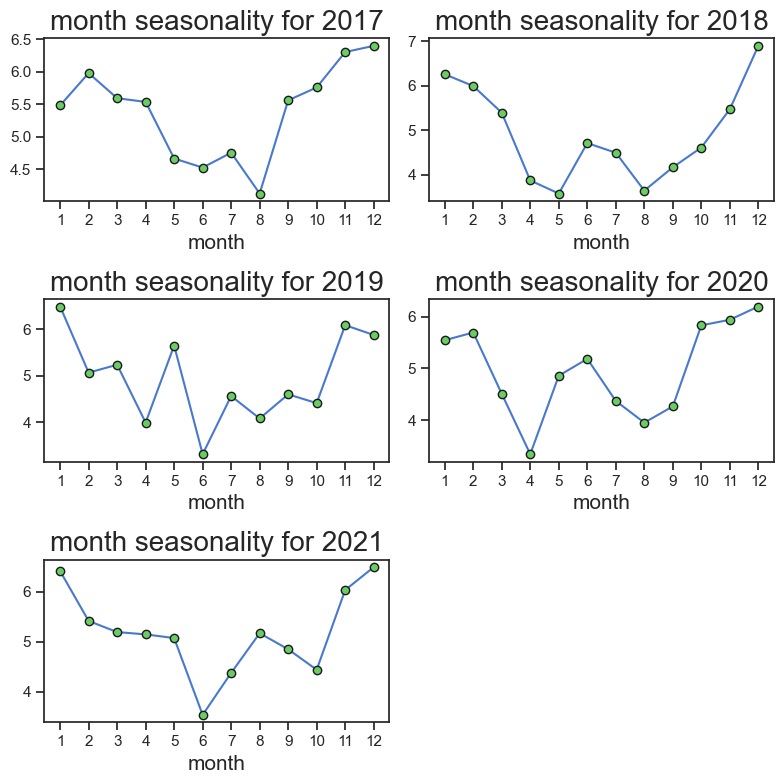

In [14]:
plot_seasonality(df=cleaned_CC, col='CC', seasonality='month')

  0%|          | 0/90 [00:00<?, ?it/s]

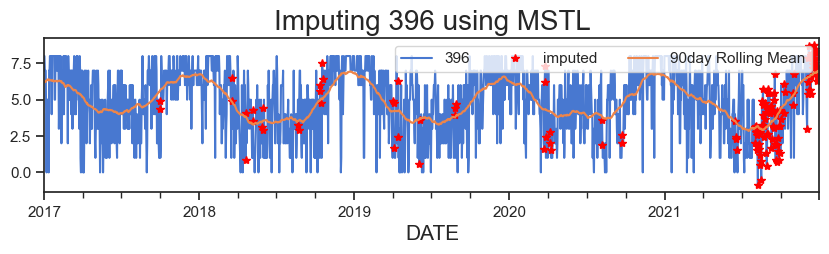

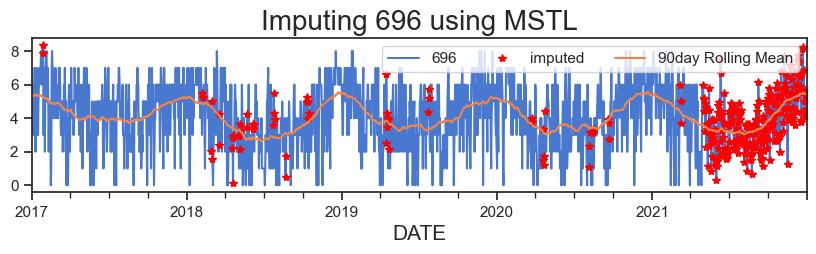

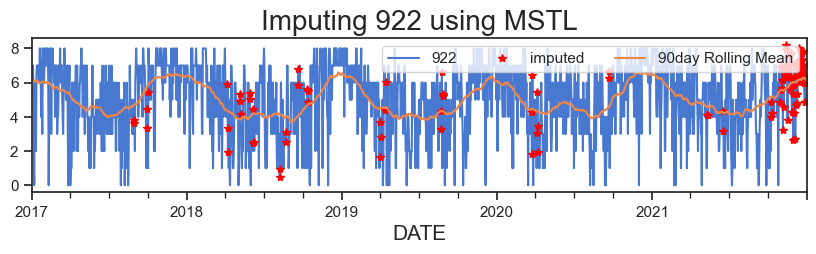

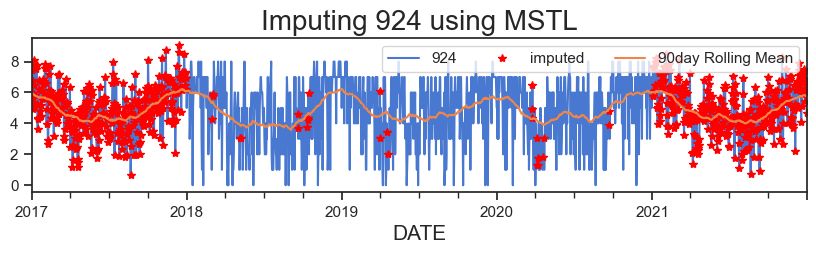

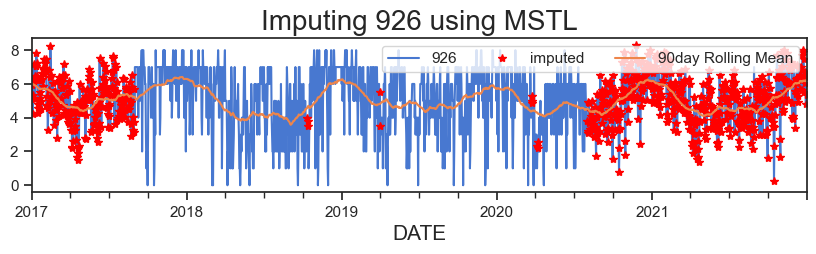

...

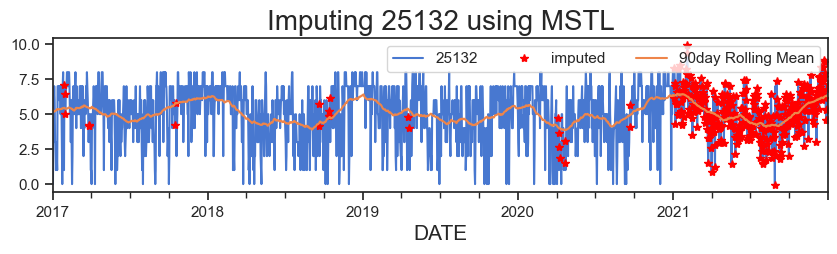

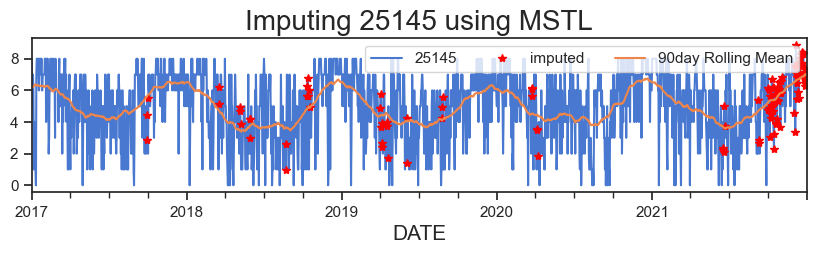

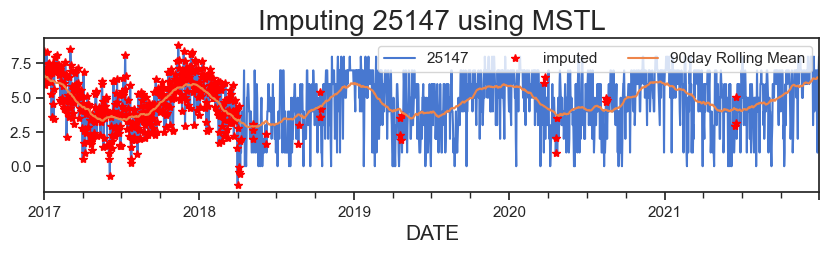

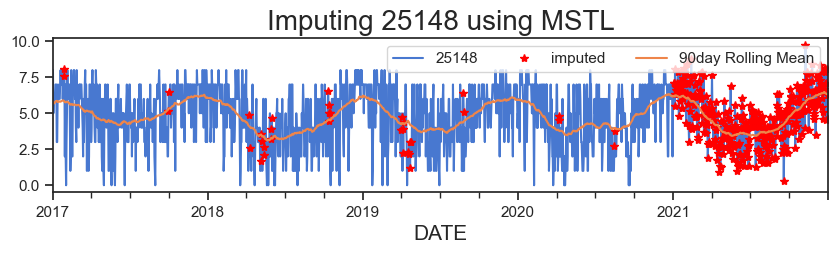

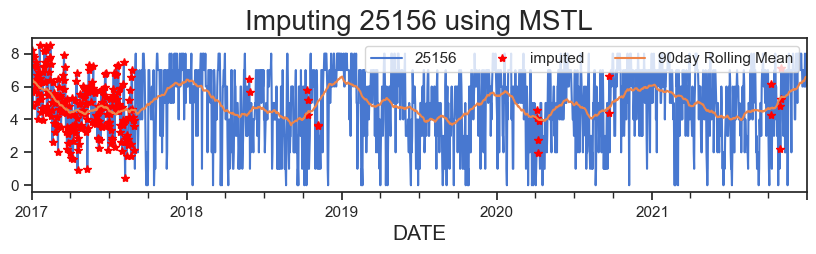

Done!
Wall time: 1min 15s


In [15]:
%%time
cleaned_CC = impute_all(df=cleaned_CC, thresh=30)

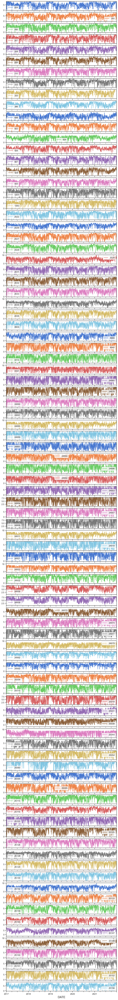

In [16]:
cleaned_CC.plot(subplots=True, figsize=(10, 90));

# Imputing Wind Speed (FG)

In [17]:
cleaned_FG = clean_data(df=df, col='FG')

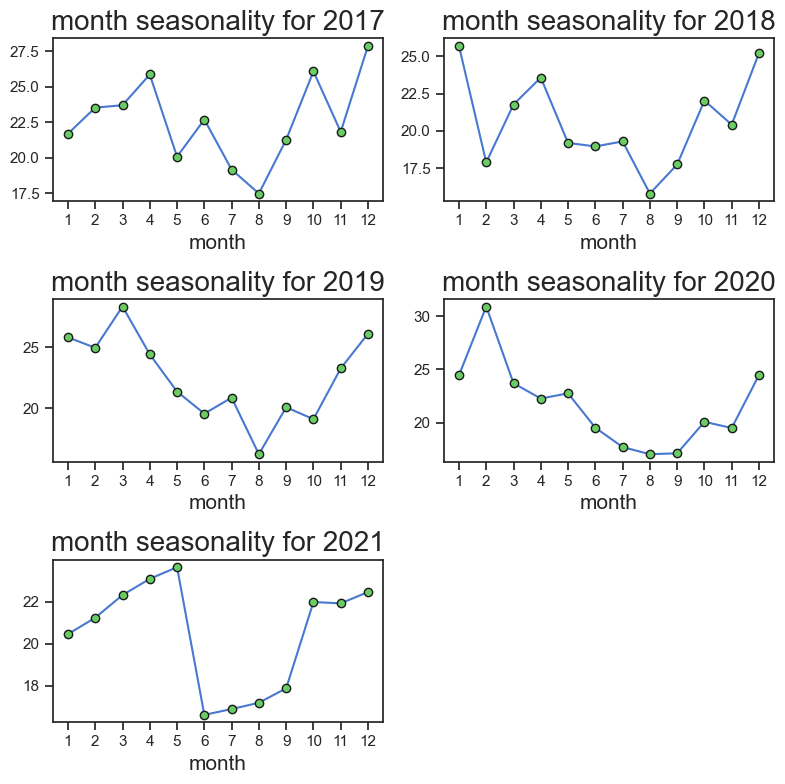

In [18]:
plot_seasonality(df=cleaned_FG, col='FG', seasonality='month')

  0%|          | 0/119 [00:00<?, ?it/s]

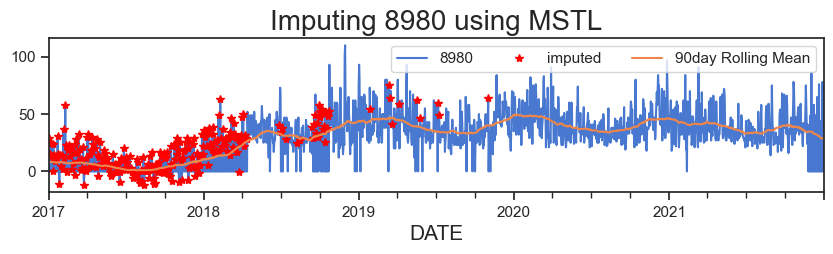

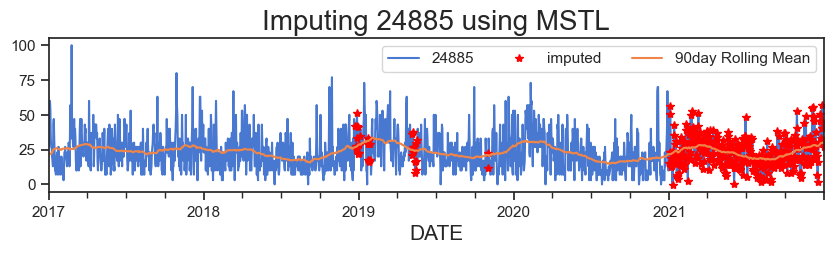

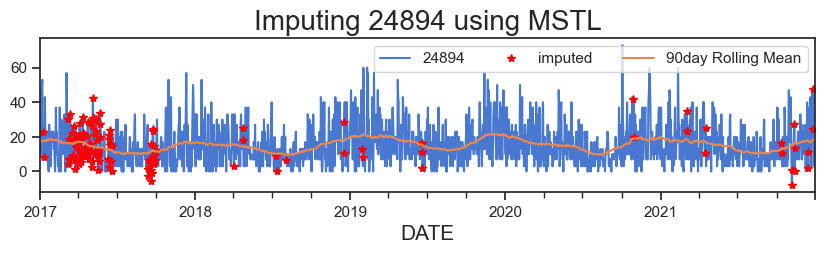

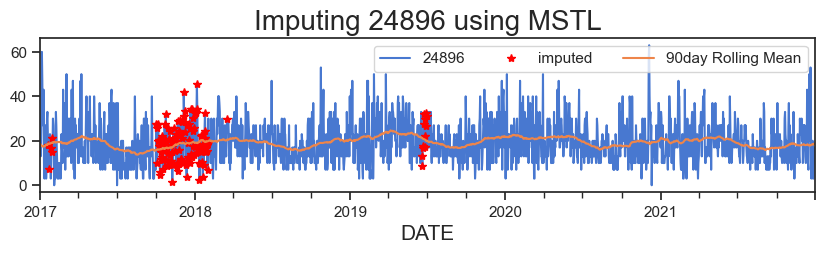

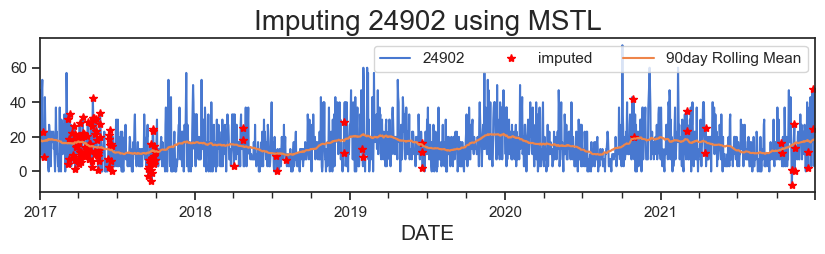

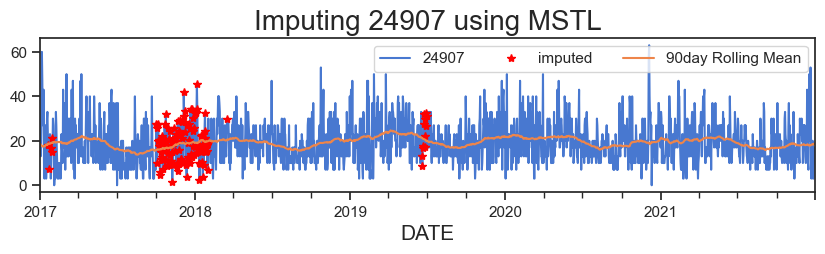

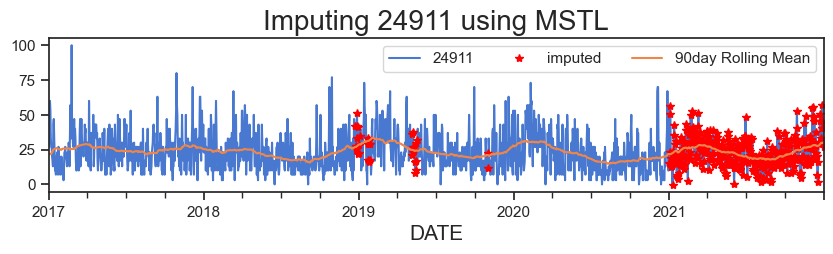

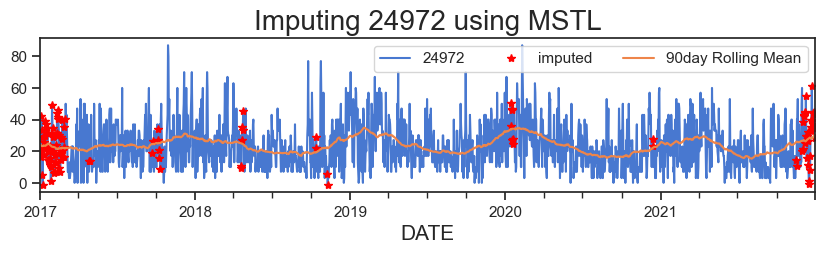

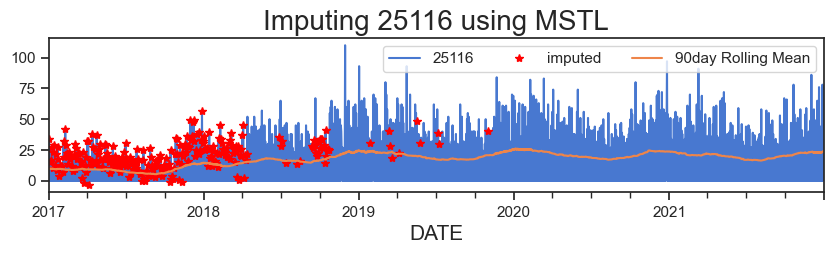

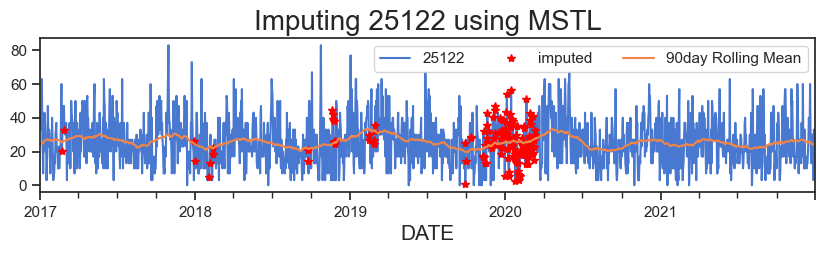

Done!


In [19]:
cleaned_FG = impute_all(df=cleaned_FG)

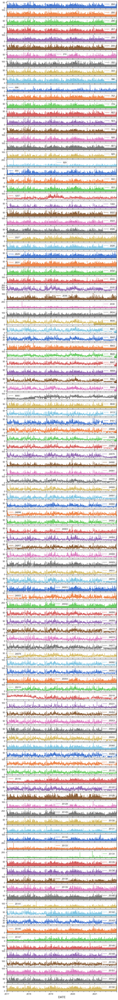

In [20]:
cleaned_FG.plot(subplots=True, figsize=(10, 90));

# humidity (HU)

In [21]:
cleaned_HU = clean_data(df=df, col='HU')

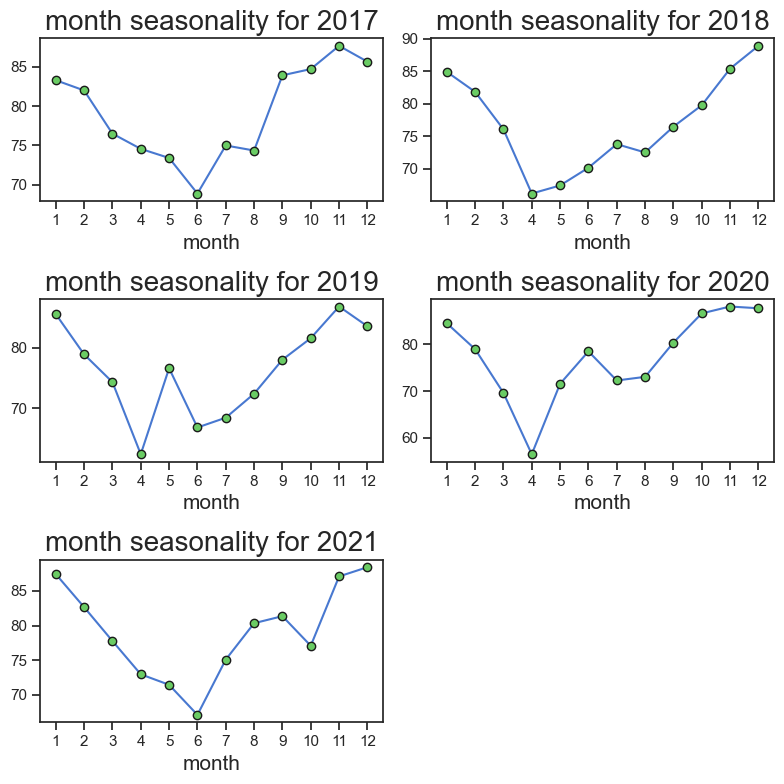

In [22]:
plot_seasonality(df=cleaned_HU, col='HU', seasonality='month')

In [23]:
cleaned_HU[[col for col in cleaned_HU.columns if col !=25031]] = \
cleaned_HU[[col for col in cleaned_HU.columns if col !=25031]].interpolate('linear', limit_direction='both')

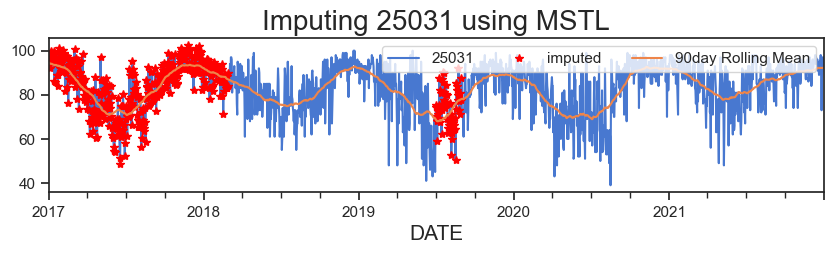

In [24]:
cleaned_HU[25031] = impute_with_MSTL(df=cleaned_HU, col=25031)

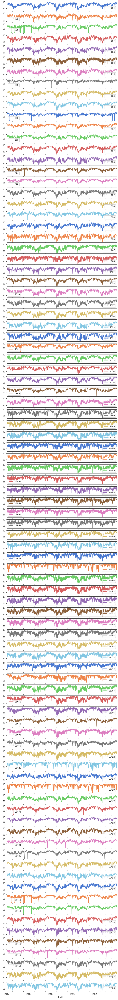

In [25]:
cleaned_HU.plot(subplots=True, figsize=(10, 90));

# Sea Level Pressure (PP)

In [26]:
cleaned_PP = clean_data(df=df, col='PP')

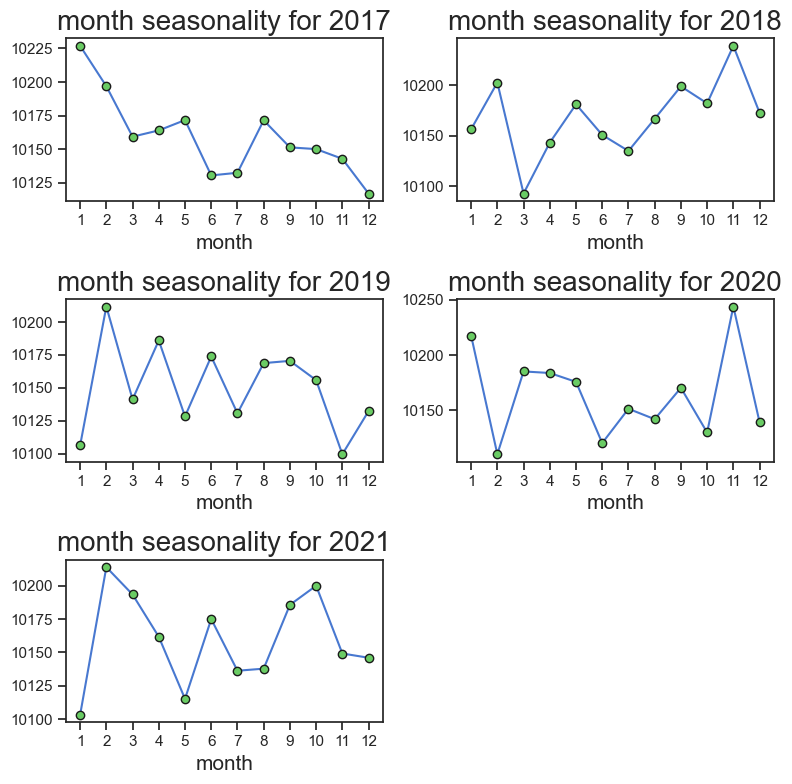

In [27]:
plot_seasonality(df=cleaned_PP, col='PP', seasonality='month')

In [28]:
for col in cleaned_PP.columns:
    cleaned_PP[col] = cleaned_PP[col].interpolate('linear', limit_direction='both')

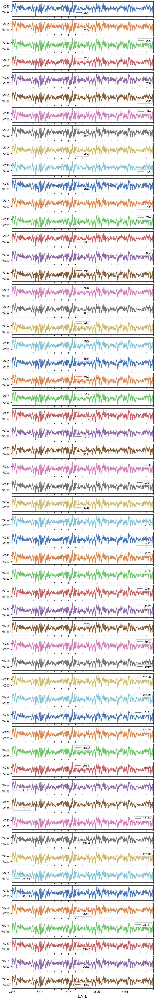

In [29]:
cleaned_PP.plot(subplots=True, figsize=(10, 70));

# global radiation (QQ)

In [30]:
cleaned_QQ = clean_data(df=df, col='QQ')

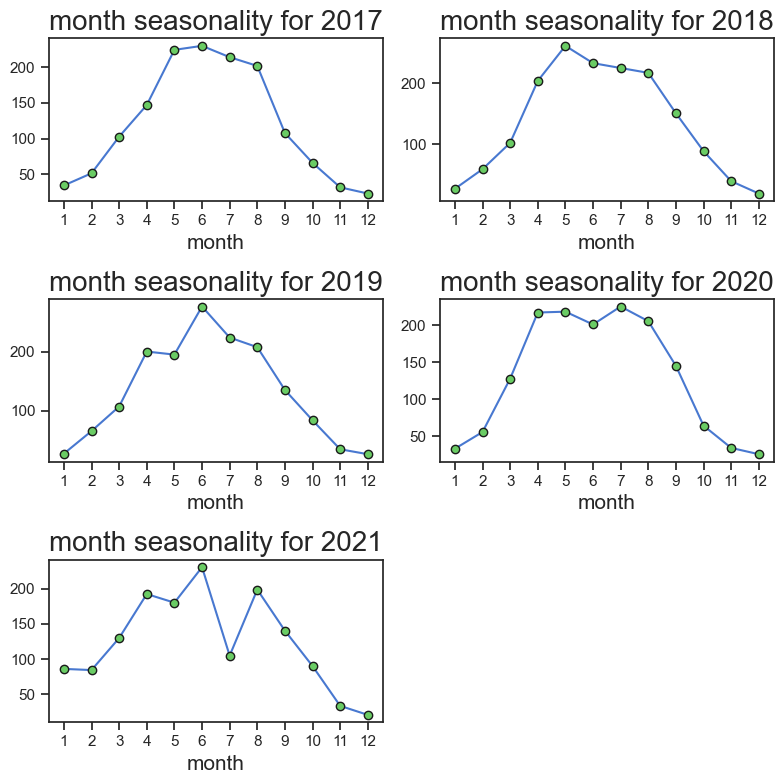

In [31]:
plot_seasonality(df=cleaned_QQ, col='QQ', seasonality='month')

  0%|          | 0/50 [00:00<?, ?it/s]

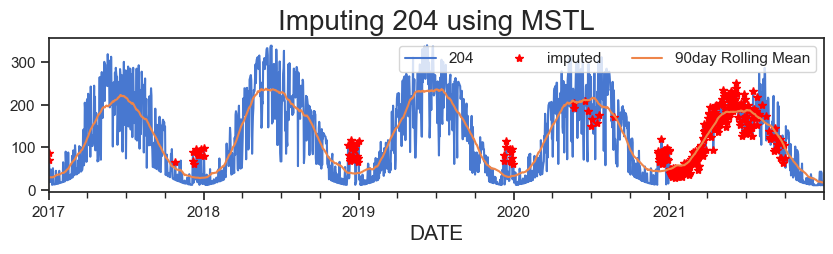

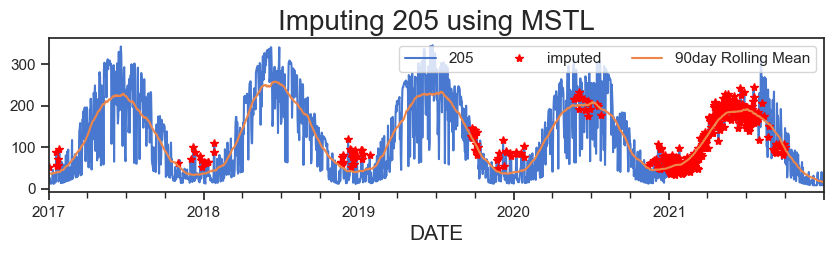

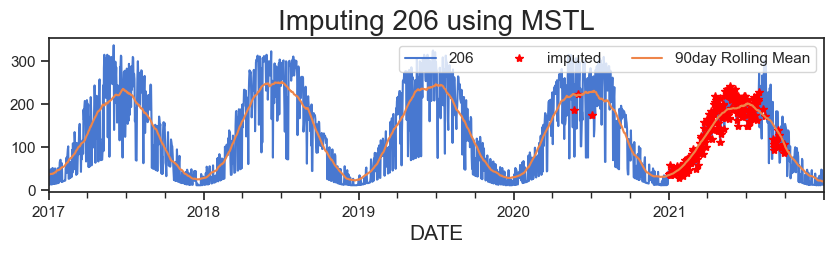

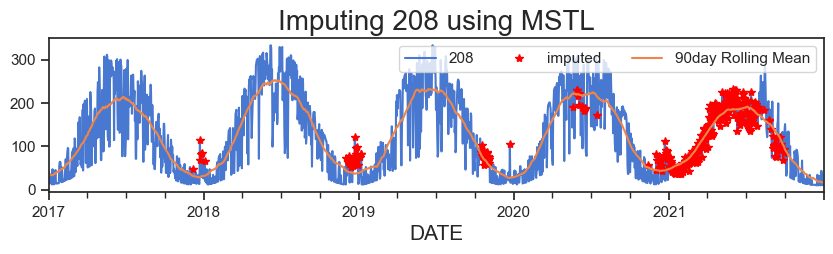

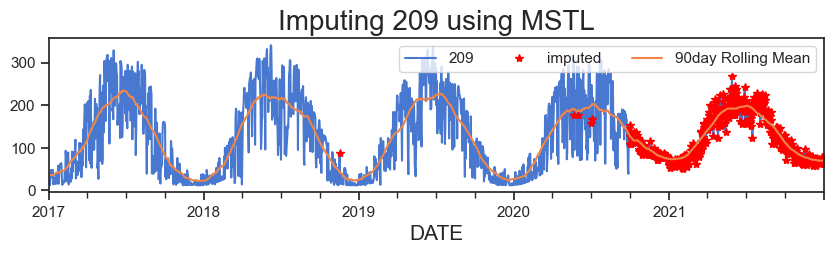

...

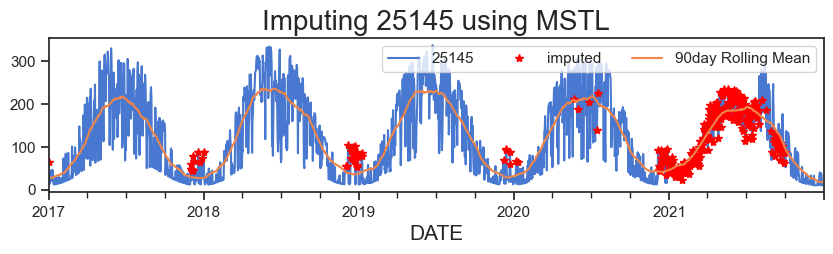

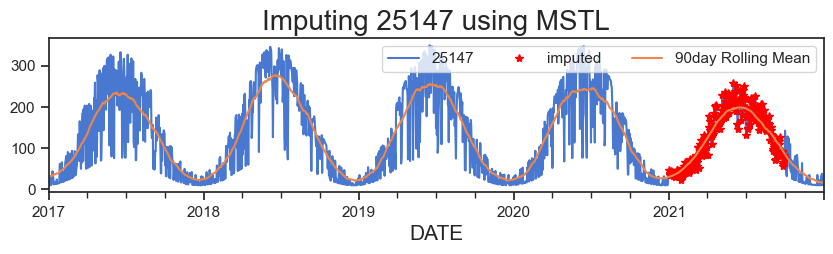

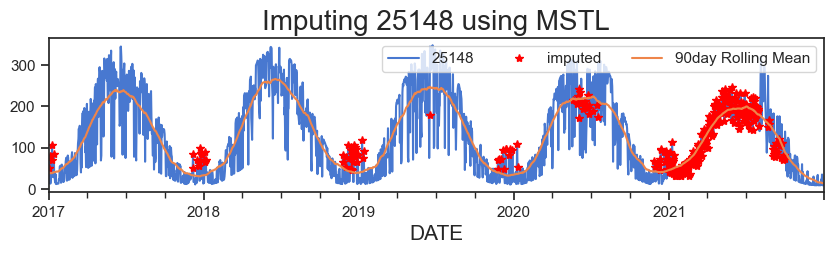

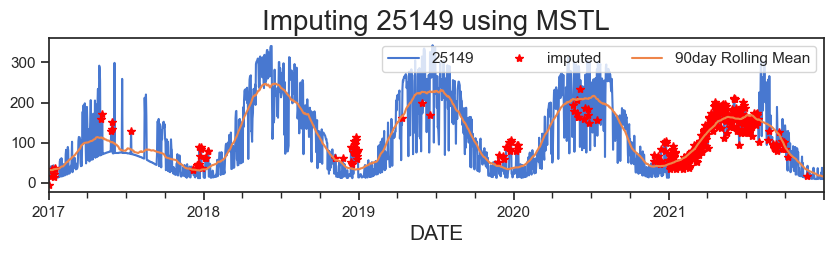

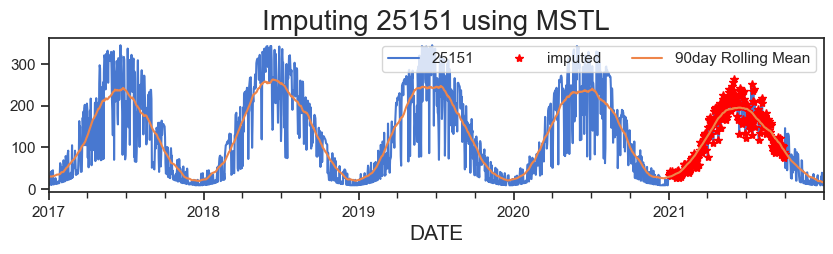

Wall time: 2min 20s


In [32]:
%%time
for col in tqdm(cleaned_QQ.columns):
    cleaned_QQ[col] = impute_with_MSTL(df=cleaned_QQ, col=col, use_resid=False)

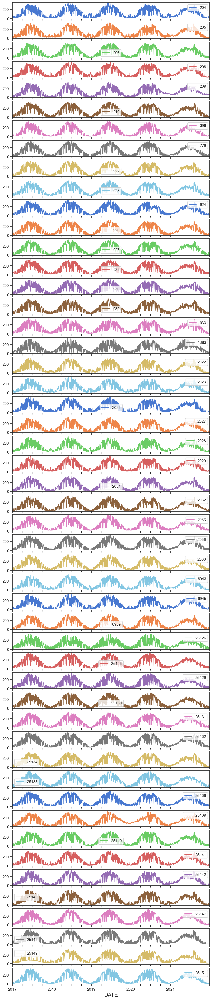

In [33]:
cleaned_QQ.plot(subplots=True, figsize=(10, 50));

# precipitation (RR)

In [34]:
cleaned_RR = clean_data(df=df, col='RR', remove_consecutive_zeros=False)

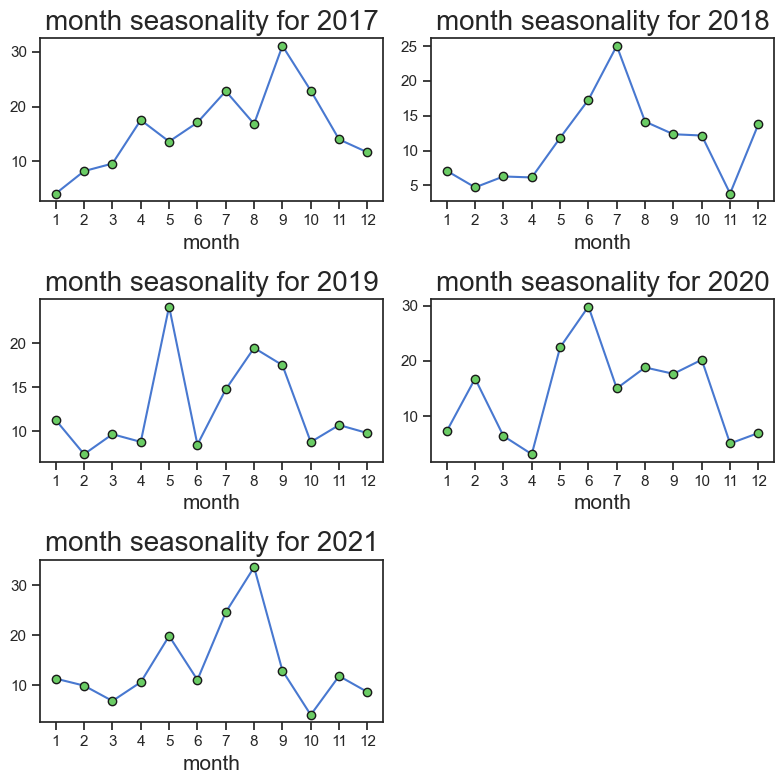

In [35]:
plot_seasonality(df=cleaned_RR, col='RR', seasonality='month')

  0%|          | 0/109 [00:00<?, ?it/s]

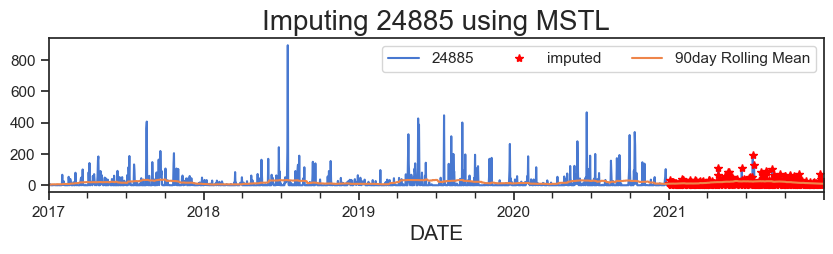

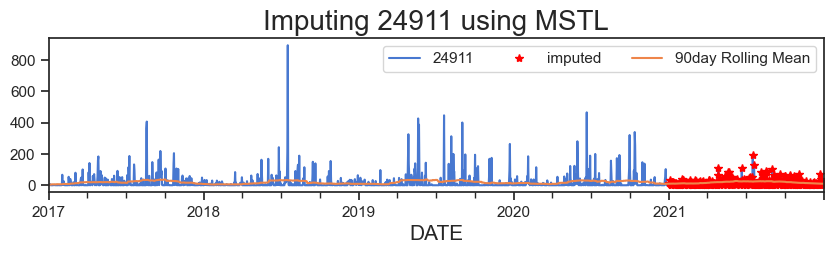

Done!
Wall time: 5.93 s


In [36]:
%%time
cleaned_RR = impute_all(df=cleaned_RR, use_resid=False, clip_neg=True)

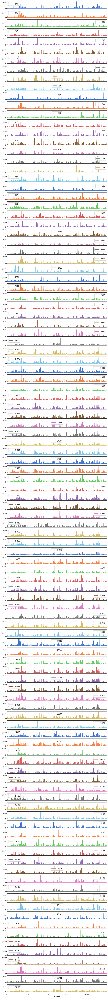

In [37]:
cleaned_RR.plot(subplots=True, figsize=(10, 100));

# snow depth (SD)

In [38]:
cleaned_SD = clean_data(df=df, col='SD', remove_consecutive_zeros=False)

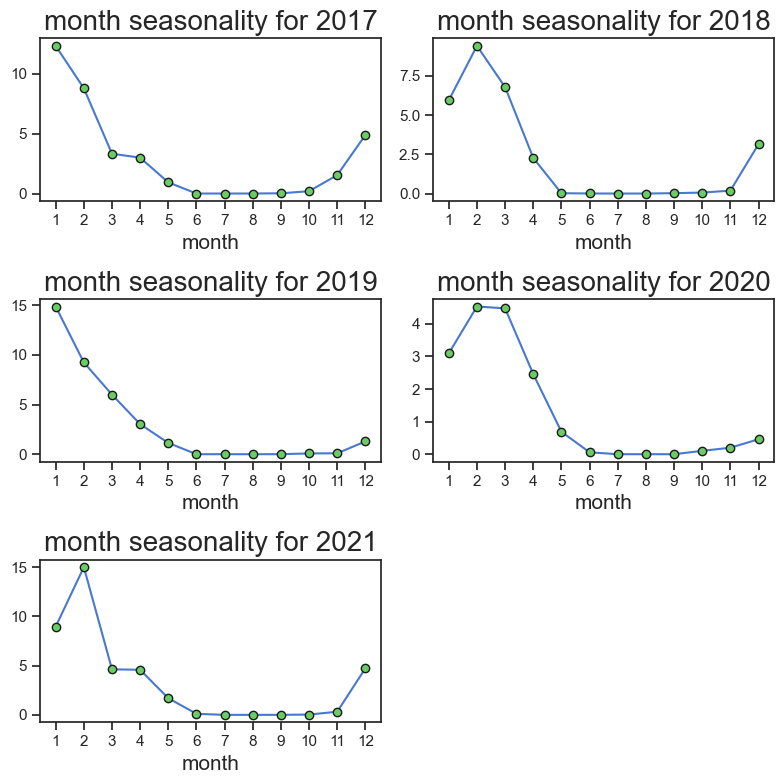

In [39]:
plot_seasonality(df=cleaned_SD, col='SD', seasonality='month')

  0%|          | 0/102 [00:00<?, ?it/s]

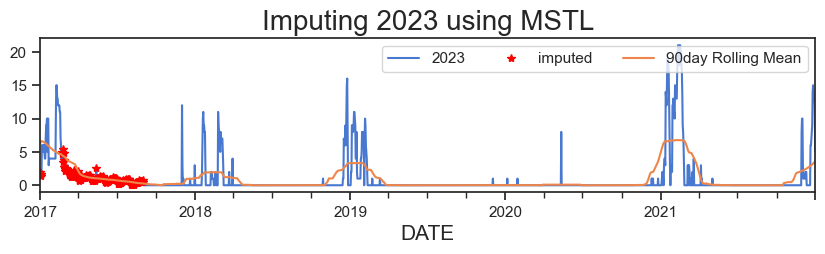

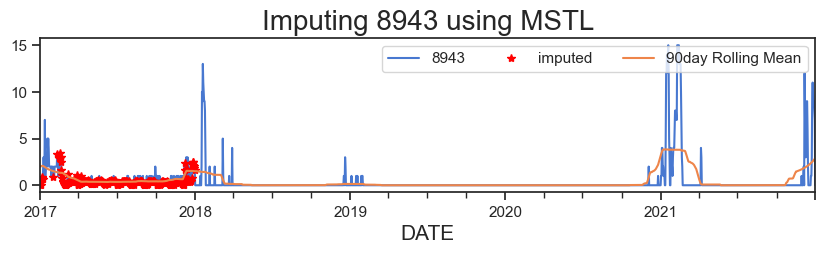

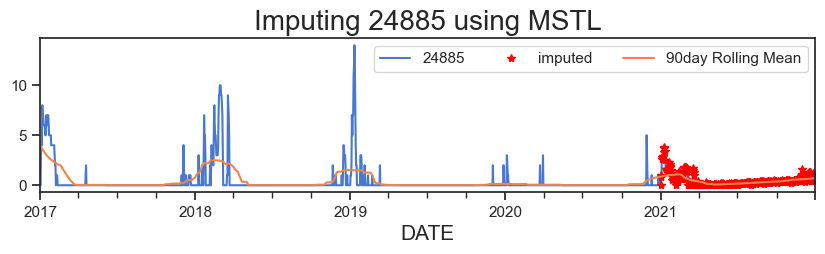

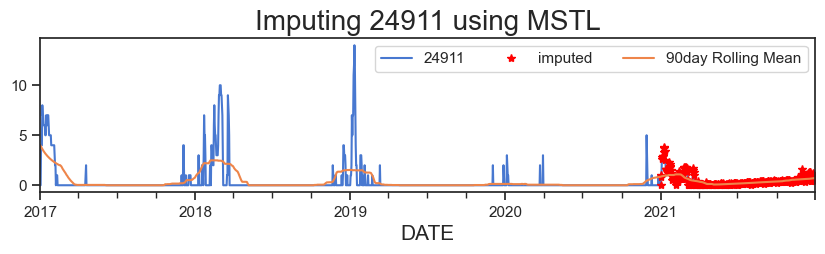

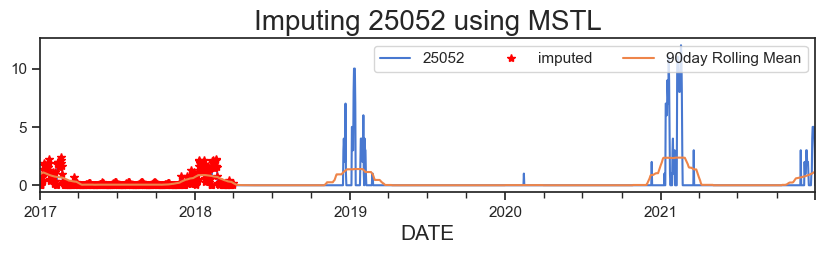

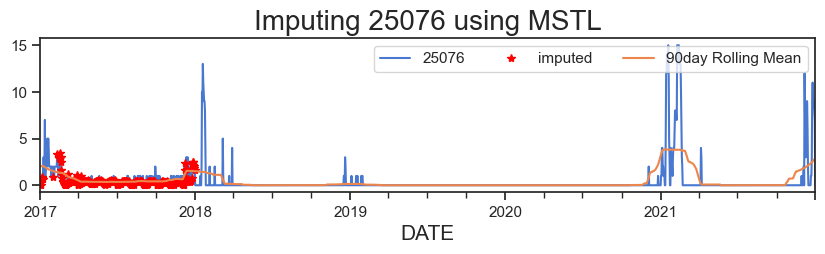

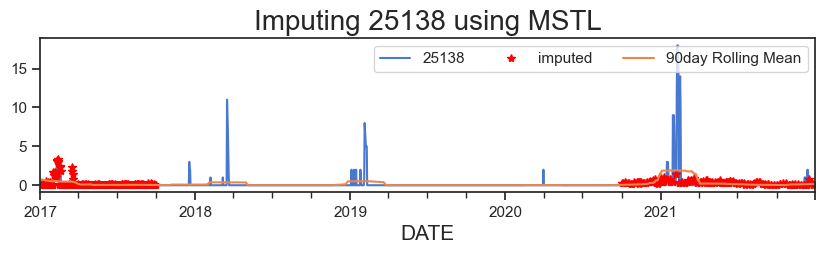

Done!
Wall time: 20.2 s


In [40]:
%%time
cleaned_SD = impute_all(df=cleaned_SD, use_resid=False, clip_neg=True)

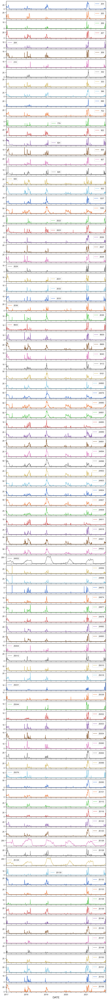

In [41]:
cleaned_SD.plot(subplots=True, figsize=(10, 100));

# Sunshine (SS)

In [42]:
cleaned_SS = clean_data(df=df, col='SS')

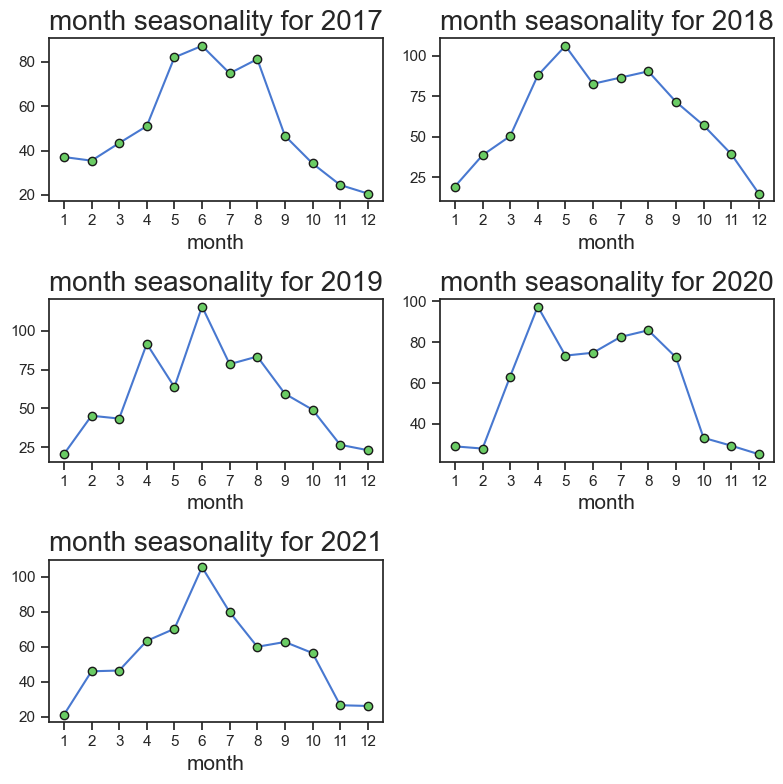

In [43]:
plot_seasonality(df=cleaned_SS, col='SS', seasonality='month')

  0%|          | 0/48 [00:00<?, ?it/s]

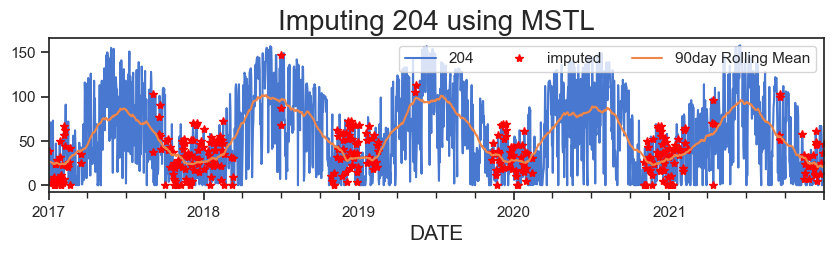

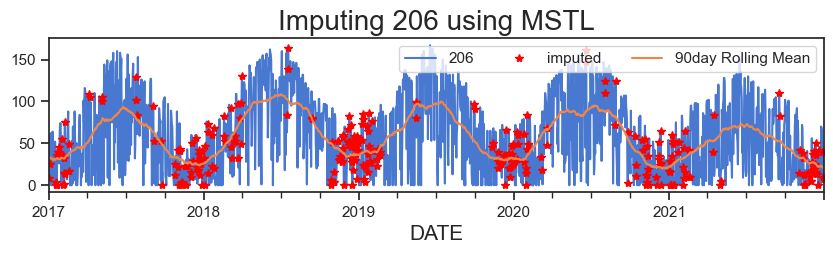

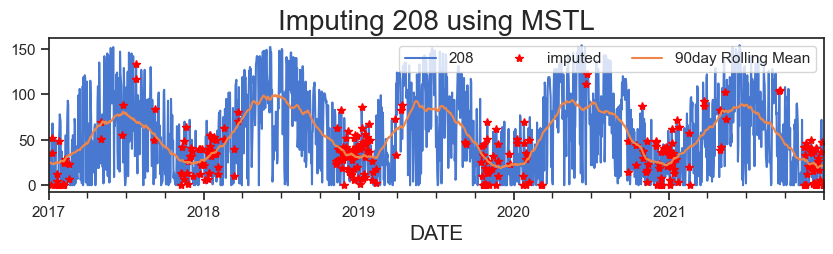

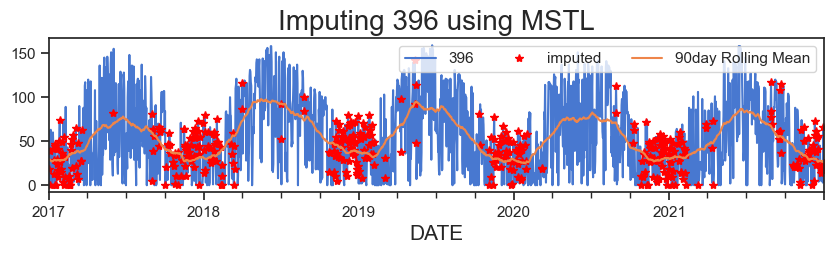

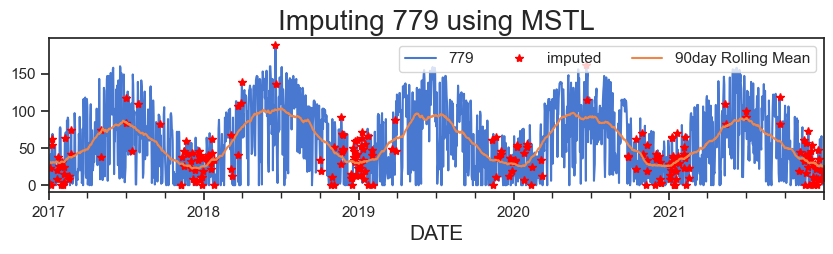

...

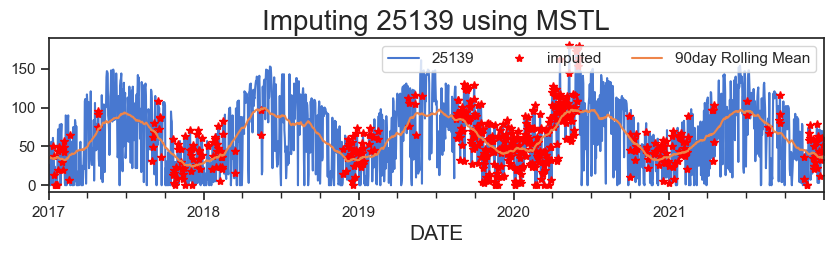

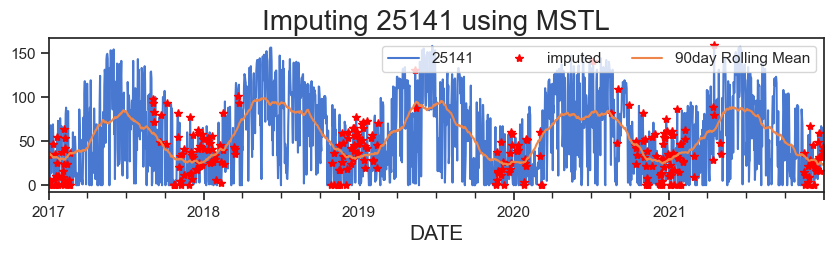

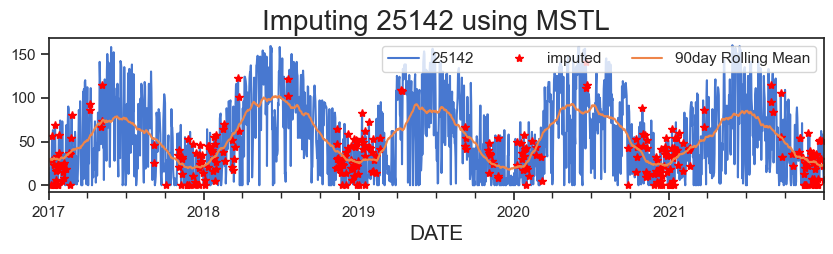

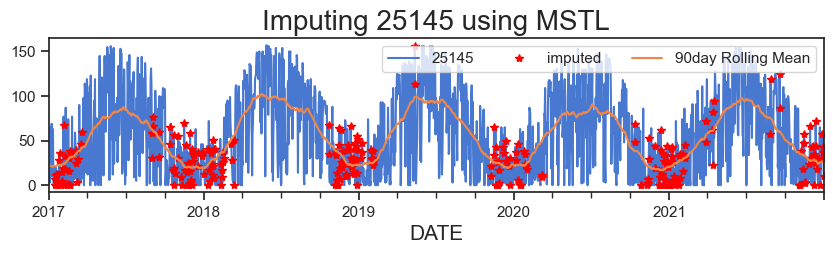

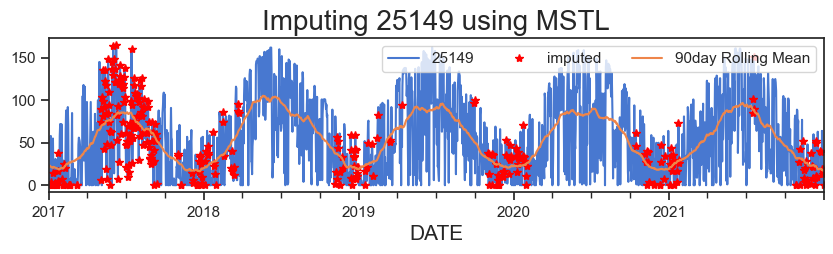

Done!
Wall time: 1min 7s


In [44]:
%%time
cleaned_SS = impute_all(df=cleaned_SS, clip_neg=True)

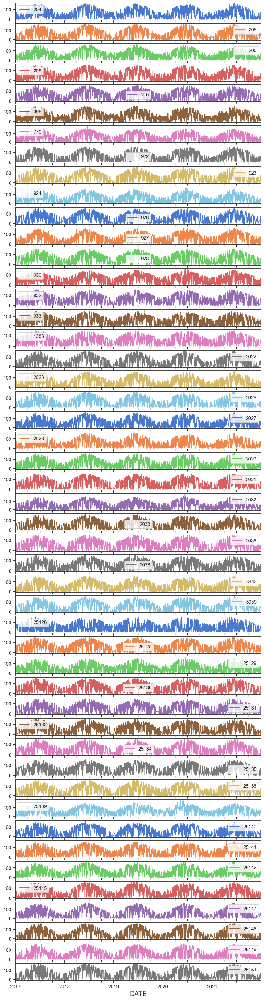

In [45]:
cleaned_SS.plot(subplots=True, figsize=(10, 40));

# Mean Temperature (TG)

In [46]:
cleaned_TG = clean_data(df=df, col='TG')

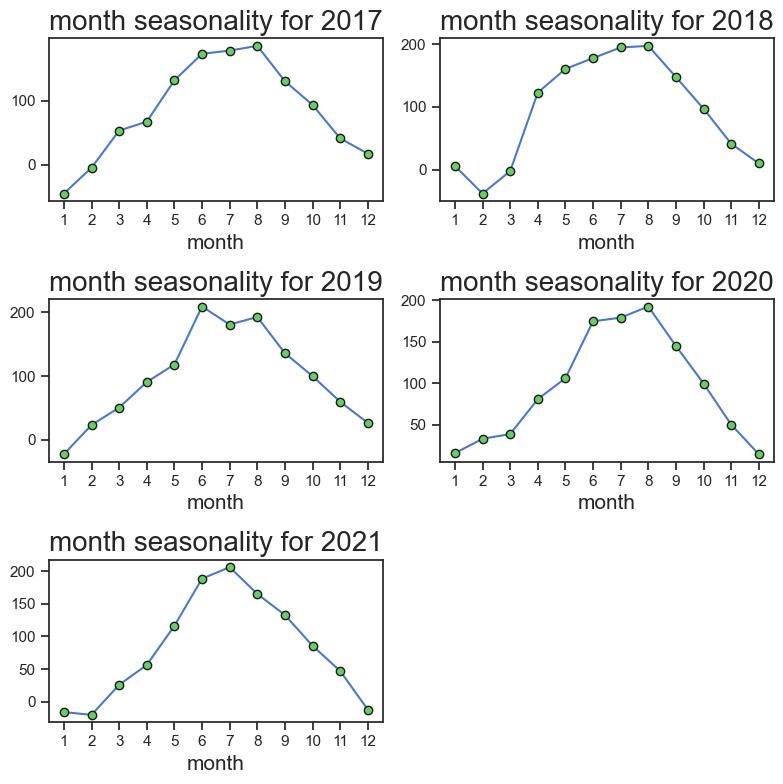

In [47]:
plot_seasonality(df=cleaned_TG, col='TG', seasonality='month')

  0%|          | 0/107 [00:00<?, ?it/s]

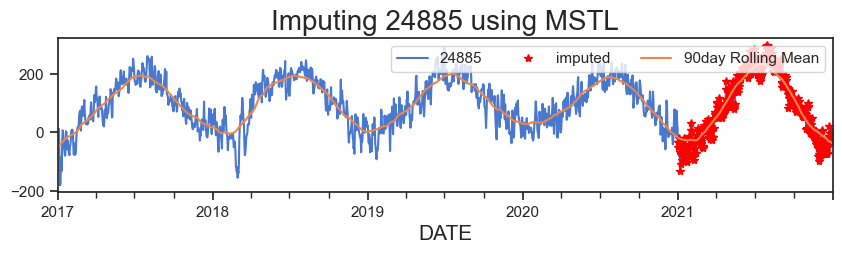

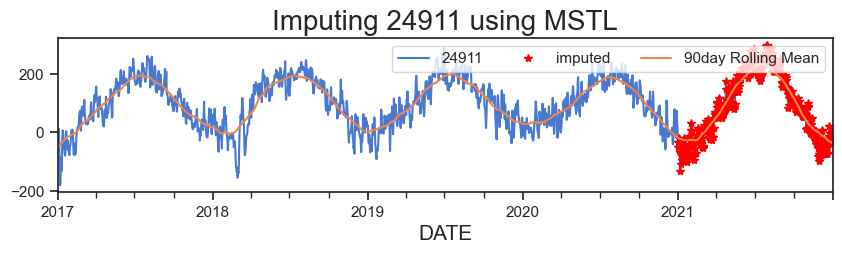

Done!
Wall time: 5.88 s


In [48]:
%%time
cleaned_TG = impute_all(df=cleaned_TG)

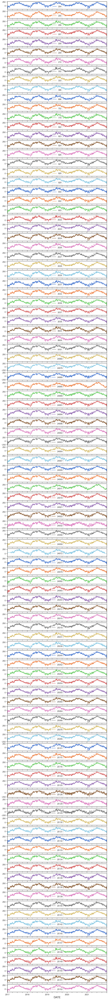

In [49]:
cleaned_TG.plot(subplots=True, figsize=(10, 100));

# Combining Cleaned DFs

In [50]:
cleaned_dfs = \
[cleaned_CC, cleaned_FG, cleaned_HU, cleaned_PP, cleaned_QQ, cleaned_RR, cleaned_SD, cleaned_SS, cleaned_TG]

In [51]:
cols=['STAID', 'DATE']

df_lists=\
[df.stack().reorder_levels(cols).sort_index().to_frame(col) for df, col in zip(cleaned_dfs, weather_cols)]

In [52]:
all_df = pd.concat(df_lists, axis=1).reset_index()

all_df

,STAID,DATE,CC,FG,HU,PP,QQ,RR,SD,SS,TG
0,204,2017-01-01,8.0,0.0,89.0,10151.0,85.859777,0.0,0.0,39.002987,4.0
1,204,2017-01-02,7.0,35.0,89.0,10069.0,70.528059,15.0,0.0,2.998211,6.0
2,204,2017-01-03,7.0,0.0,91.0,10090.0,18.000000,0.0,1.0,7.000000,-14.0
3,204,2017-01-04,8.0,32.0,93.0,9885.0,20.000000,50.0,7.0,0.000000,3.0
4,204,2017-01-05,6.0,0.0,83.5,10101.0,20.000000,0.0,16.0,9.000000,-108.0
...,...,...,...,...,...,...,...,...,...,...,...
235549,25101,2021-12-27,NaN,NaN,NaN,NaN,NaN,0.0,3.0,NaN,-71.0
235550,25101,2021-12-28,NaN,NaN,NaN,NaN,NaN,0.0,3.0,NaN,-96.0
235551,25101,2021-12-29,NaN,NaN,NaN,NaN,NaN,0.0,2.0,NaN,-80.0
235552,25101,2021-12-30,NaN,NaN,NaN,NaN,NaN,12.0,2.0,NaN,-22.0


In [53]:
full_df = all_df.merge(station_info, how='left', on='STAID')

In [54]:
full_df['TG'] = full_df['TG']*0.1

In [55]:
# full_df.to_csv("Weather_Imputed_StationLvl.csv", index=False)

# Aggregating by Powiat

In [59]:
full_df['powiat_voivod'] = \
full_df['county'].str.strip().str.lower() + ", " + \
full_df['Voivodeship'].str.split().str[1].str.lower()

In [62]:
powiat_df = full_df.groupby(['powiat_voivod', 'DATE']).mean().reset_index()

In [64]:
powiat_df = powiat_df.drop('STAID', axis=1)

In [65]:
powiat_df.head()

,powiat_voivod,DATE,CC,FG,HU,PP,QQ,RR,SD,SS,TG,LAT,LON
0,"powiat bialski, lubelskie",2017-01-01,6.0,0.0,78.0,10172.0,12.0,0.0,0.0,7.240682,0.9,52.078611,23.621944
1,"powiat bialski, lubelskie",2017-01-02,7.0,34.0,78.0,10092.0,12.0,31.0,0.0,5.418323,-0.1,52.078611,23.621944
2,"powiat bialski, lubelskie",2017-01-03,6.0,0.0,84.5,10109.0,24.0,0.0,5.0,12.000000,-1.4,52.078611,23.621944
3,"powiat bialski, lubelskie",2017-01-04,7.0,49.0,91.0,9918.0,20.0,52.0,9.0,6.000000,0.8,52.078611,23.621944
4,"powiat bialski, lubelskie",2017-01-05,6.0,0.0,84.5,10079.0,13.0,0.0,13.0,0.000000,-8.8,52.078611,23.621944


In [ ]:
powiat_df.to_csv("Weather_Imputed_PowiatLvl.csv", index=False)